# Rock Music

<img src="../assets/img/rock_music.png" width="750" align="center">

## 1. Setup

In [44]:
%reload_ext autoreload 
%autoreload 2
import sys
import os
import math
sys.path.append('../')
from phonon_sonification import MP_interface
import matplotlib.pyplot as plt
from strauss.sonification import Sonification
from strauss.sources import Events, Objects
from strauss import channels
from strauss.score import Score
from strauss.generator import Spectralizer
import IPython.display as ipd
from scipy.interpolate import interp1d
import numpy as np
import pathlib
%matplotlib inline

## 2. Sonification parameters

In [15]:
# specify audio system (e.g. mono, stereo, 5.1, ...)
system = "stereo"

# length of the sonification in s
length = 10.

## 3. Define functions

A note on the frequency range: this has been chosen as the sensitivity of the ear is fairly constant across this range for anything above ~20dB. See: https://www.audioholics.com/room-acoustics/physics-tutorial-2-the-physics-of-hearing.

TODO: move all functions to a Python module

In [ ]:
def play_gamma_modes(mp_id,chem_form,freq_lims=None,mapping=None,temp=None):
    
    pass
    # TODO: play gamma mode frequencies as a chord, play multiple materials as a sequence of chords, play the notes randomly within a chord

def get_min_max_frequencies(mp_id_list):
    
    freq_list=[]
    for mp_id in mp_id_list:
        phonon_frequencies, dos = MP_interface.dos_data_from_mp_id(mp_id)
        freq_list.append(phonon_frequencies)

    freq_list = [x for xs in freq_list for x in xs]

    min_freq = min(freq_list)
    if min_freq < 0:
        min_freq=0

    return (min_freq, max(freq_list))  

def spectralise(amplitudes,min_spectrum,max_spectrum,mapping=None):
    notes = [["A2"]]
    
    score =  Score(notes, length)
    
    #set up spectralizer generator
    generator = Spectralizer()
    
    # Lets pick the mapping frequency range for the spectrum...
    generator.modify_preset({'min_freq':200, 'max_freq':5000})

    if mapping == "attenuate_low_freq":
        amplitudes = amplitudes * [x for x in range(len(amplitudes))]  # apply linear mapping

    if mapping == "amplify_large_dos":
        amplitudes = amplitudes = [x**2 if x>(0.5*max(amplitudes)) else x for x in amplitudes] # anything in the upper 50% of dos is squared

    if callable(mapping)==True:
        amplitudes = amplitudes * [mapping(x) for x in range(len(amplitudes))]  # apply a lambda mapping 

    if mapping is not None:
        plt.plot(amplitudes)
        plt.xlabel('frequencies')
        plt.ylabel('amplitude')
        plt.show()
        
    # set up spectrum and choose some envelope parameters for fade-in and fade-out
    data = {'spectrum':[amplitudes], 'pitch':[1], 
            'volume_envelope/D':[0.9], 
            'volume_envelope/S':[0.], 
            'volume_envelope/A':[0.05]}

    print(min_spectrum,max_spectrum)
    # again, use maximal range for the mapped parameters
    lims = {'spectrum': (str(min_spectrum),str(max_spectrum))}
    
    # set up source
    sources = Events(data.keys())
    sources.fromdict(data)
    sources.apply_mapping_functions(map_lims=lims)
    
    # render and play sonification!
    soni = Sonification(score, sources, generator, system)
    soni.render()
    soni.notebook_display(show_waveform=0)

def spectralise_dos(mp_id,chem_form,freq_lims=None,mapping=None):

    # mapping will weight the data amplitudes. A lambda function can be passed as an argument, or you can use the "attentuate_low_freq" option.
    # you can manually specify wider frequency limits rather than using the min and max of the spectral data. This is useful when making comparisons
    # between different datasets.
    
    phonon_frequencies, dos = MP_interface.dos_data_from_mp_id(mp_id)
    plt.plot(np.array(phonon_frequencies)/1E12, dos)
    plt.xlabel('frequencies THz')
    plt.ylabel('density of states')
    plt.title(chem_form)
    plt.show()

    if freq_lims:
        min_spectrum = ((min(phonon_frequencies) - freq_lims[0])/(freq_lims[1]-freq_lims[0]))*100
        max_spectrum = ((max(phonon_frequencies) - freq_lims[0])/(freq_lims[1]-freq_lims[0]))*100
    else:
        min_spectrum=0
        max_spectrum=100
        
    spectralise(dos,min_spectrum=0,max_spectrum=max_spectrum,mapping=mapping)

    

Retrieving PhononBSDOSDoc documents: 100%|██████| 1/1 [00:00<00:00, 7810.62it/s]

There are 3 imaginary frequencies which have not been processed


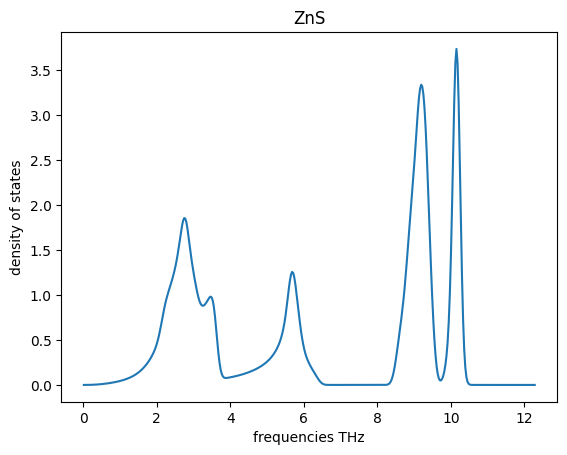

0 22.180043383947947


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  5.82it/s]


In [175]:
spectralise_dos("mp-10695","ZnS",freq_lims=min_max)

Retrieving PhononBSDOSDoc documents: 100%|██████| 1/1 [00:00<00:00, 8208.03it/s]


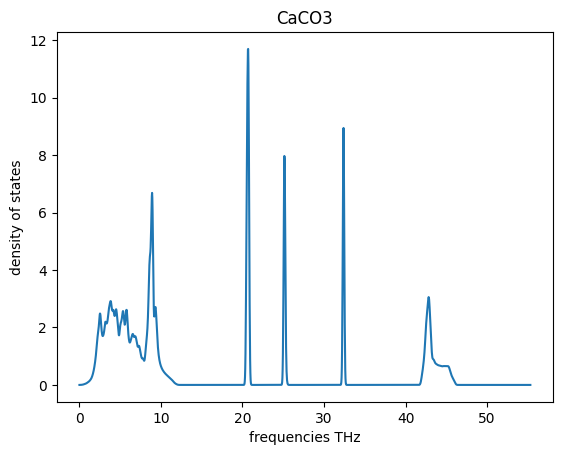

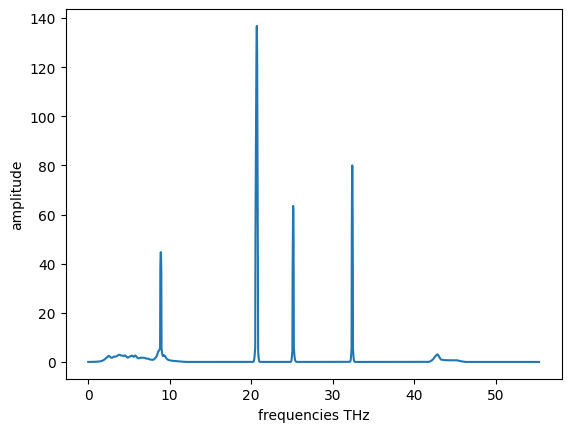

0 100.0


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  4.67it/s]


In [84]:
spectralise_dos("mp-3953","CaCO3",freq_lims=min_max,mapping="amplify_large_dos")

Retrieving PhononBSDOSDoc documents: 100%|█████| 1/1 [00:00<00:00, 12372.58it/s]


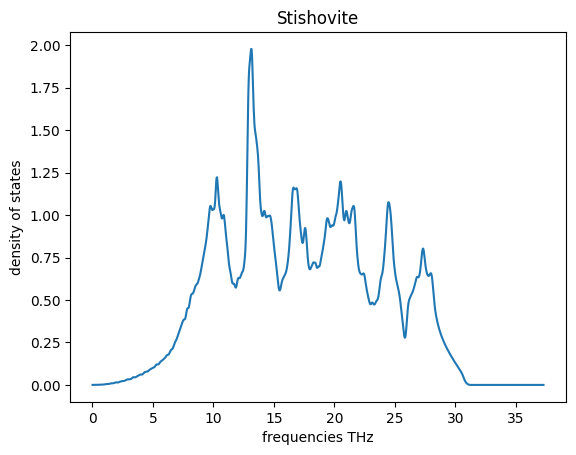

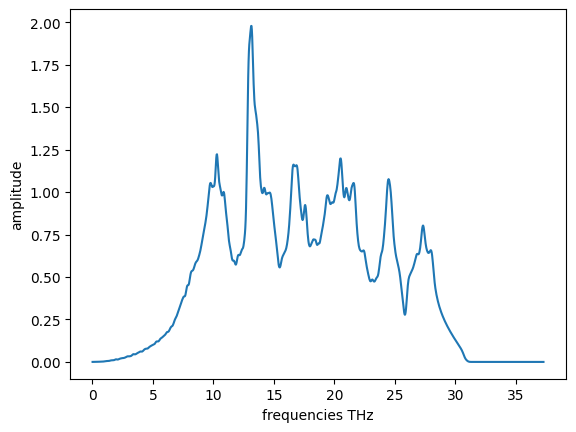

0 67.40780911062907


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  6.92it/s]


In [66]:
spectralise_dos("mp-6947","Stishovite",freq_lims=min_max)

Retrieving PhononBSDOSDoc documents: 100%|██████| 1/1 [00:00<00:00, 2618.17it/s]


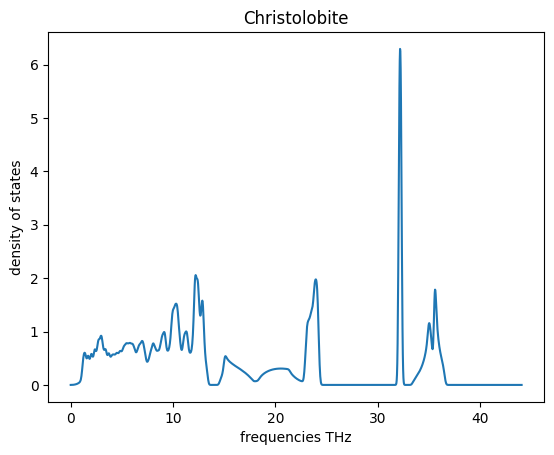

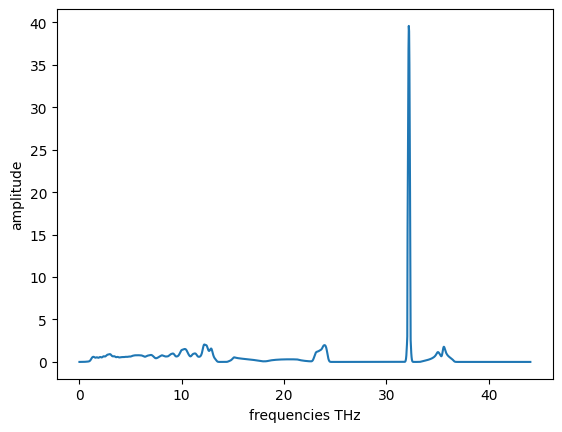

0 79.66377440347074


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  6.24it/s]


In [86]:
spectralise_dos("mp-546794","Christolobite",freq_lims=min_max,mapping="amplify_large_dos")

Retrieving PhononBSDOSDoc documents: 100%|█████| 1/1 [00:00<00:00, 14979.66it/s]


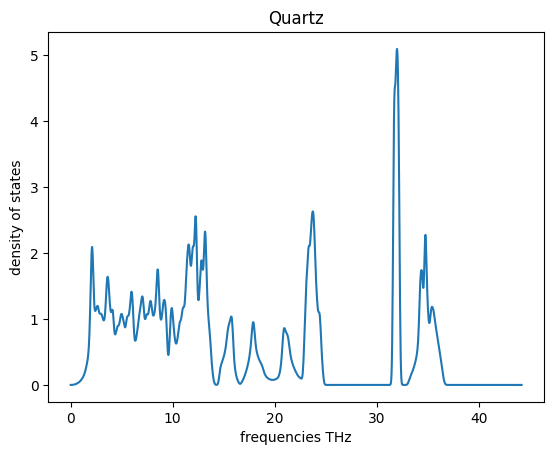

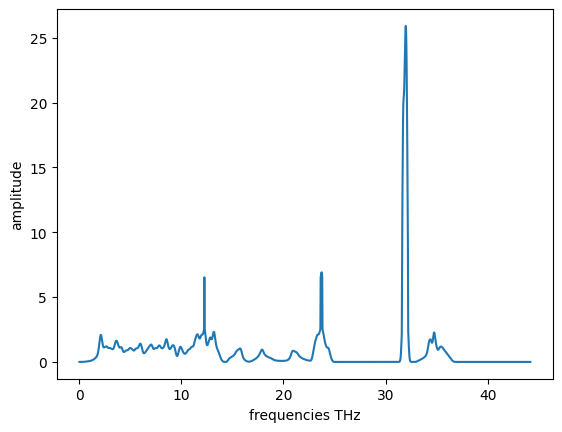

0 79.88069414316705


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  7.53it/s]


In [87]:
spectralise_dos("mp-6930","Quartz",freq_lims=min_max,mapping="amplify_large_dos")

Retrieving PhononBSDOSDoc documents: 100%|█████| 1/1 [00:00<00:00, 11781.75it/s]

There are 66 imaginary frequencies which have not been processed


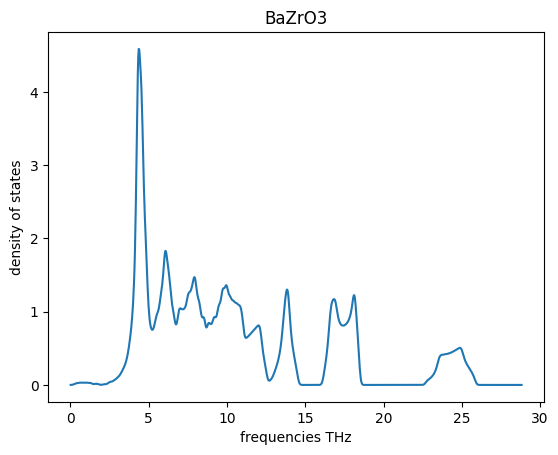

0 52.10807185859214


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  5.14it/s]


In [178]:
spectralise_dos("mp-3834","BaZrO3",freq_lims=min_max)

Retrieving PhononBSDOSDoc documents: 100%|█████| 1/1 [00:00<00:00, 16320.25it/s]

There are 3 imaginary frequencies which have not been processed


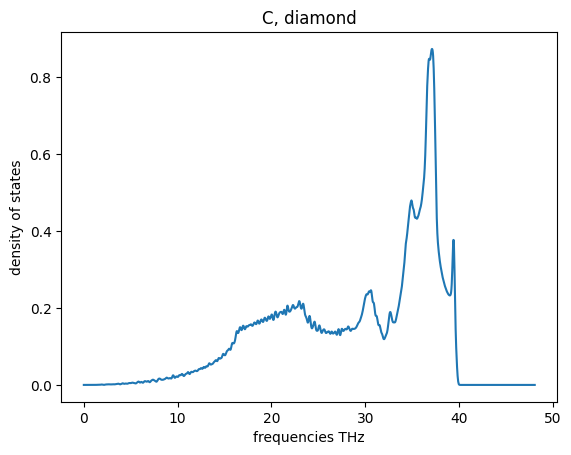

0 86.8763557483731


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  3.25it/s]


In [179]:
spectralise_dos("mp-66","C, diamond",freq_lims=min_max)

Retrieving PhononBSDOSDoc documents: 100%|██████| 1/1 [00:00<00:00, 7943.76it/s]

There are 3 imaginary frequencies which have not been processed


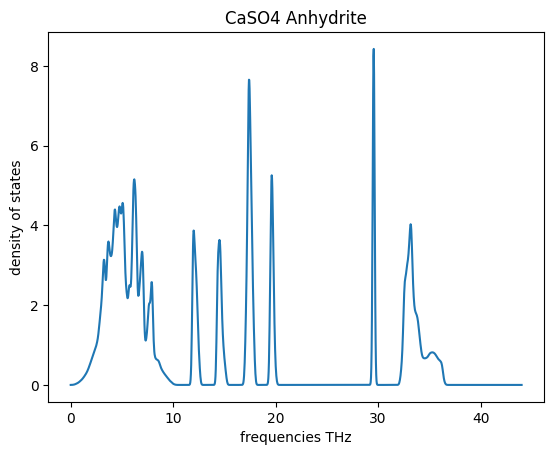

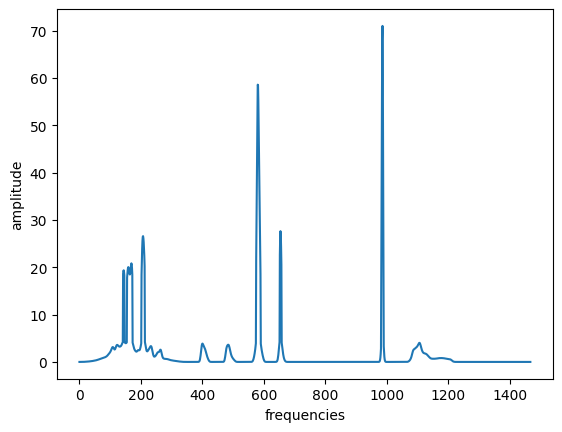

0 79.55531453362256


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.92it/s]


In [183]:
spectralise_dos("mp-4406","CaSO4 Anhydrite",freq_lims=min_max,mapping="amplify_large_dos")

Retrieving PhononBSDOSDoc documents: 100%|█████| 1/1 [00:00<00:00, 11683.30it/s]

There are 3 imaginary frequencies which have not been processed


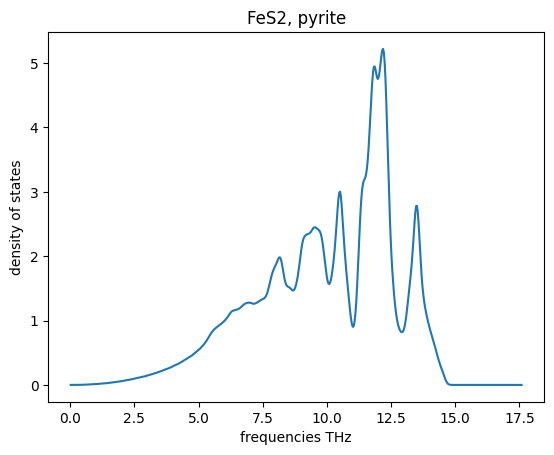

0 31.77874186550977


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  7.44it/s]


In [185]:
spectralise_dos("mp-1522","FeS2, pyrite",freq_lims=min_max)